In [2]:

import numpy as np

import rdkit
from rdkit import Chem
from rdkit.Chem import RDConfig
from rdkit.Chem import rdChemReactions
from rdkit.Chem import AllChem
from rdkit.Chem import Draw,BRICS,Recap
from rdkit.Chem.Draw import IPythonConsole
from rdkit.Chem import rdmolops
from rdkit.Chem.BRICS import BRICSDecompose
from PIL import Image

from rdkit.Chem import rdDepictor
from rdkit.Chem import Draw
from rdkit.Chem.Draw import rdMolDraw2D
from IPython.display import SVG, display

import sys
import re
import tqdm
import os

sys.path.append(os.path.join(RDConfig.RDContribDir, 'SA_Score'))
import sascorer
import pandas as pd


In [4]:

fragments_df= pd.read_csv('D:\drug_modelling\\big_fragments.csv')
display(fragments_df.tail())

,Fragment_SMILES,Attachment_Points
6021,c1ccc2c(c1)OCO2,"[0, 1, 4]"
6022,N1CC(=O)NC(=O)C1,[0]
6023,c1ccc2ccc(Cl)cc2n1,[0]
6024,n1cnc2c(nnn2)c1=O,[]
6025,C1OC(=N)C[C@@]2(C(=O)Nc3ccccc32)C1,"[0, 3, 14]"


In [55]:
df2 = pd.read_excel('big_data.xlsx')

num_duplicates = df2.duplicated().sum()

print(f"Number of duplicate rows: {num_duplicates}")
display(df2)
df2.drop([0],inplace = True)
df2.reset_index(inplace = True,drop = True)
df2.rename(columns={'SMILES': 'SMILE'}, inplace=True)
# df2.rename({'pMIC':'Reward'},axis = 1,inplace = True)

Number of duplicate rows: 87


,SMILES,Mean_50uM
0,Nc1nnc(o1)-c1ccc(o1)[N+](=O)[O-],0.088975
1,O[C@H]1COC[C@@H]2O[C@H](CC[C@H]2N(C1)C(=O)Nc1c...,0.090625
2,CC(C)C[C@@H](N)C(=O)N[C@@H]1[C@H](O)c2ccc(c(c2...,0.091557
3,[O-][N+](=O)c1ccc(o1)/C=N/N1CC(=O)NC1=O,0.092539
4,Cn1cnc(c1)CCNC(=O)C[C@@H]1CC[C@@H]2[C@H](COC[C...,0.092865
...,...,...
39307,COc1cc(ccc1NN=C1C=Cc2c(c(c(cc2S(=O)(=O)O)S(=O)...,4.124674
39308,CN(C)c1ccc(C(=C2C=CC(=[N+](C)C)C=C2)c2ccc(N(C)...,5.036600
39309,COC(=O)CCc1c(c/2[nH]c1/C=C/1\N=C(/C=C/3\N=C(/C...,5.921118
39310,Cc1cc(-c2ccc(N=Nc3ccc4c(S(=O)(=O)[O-])cc(S(=O)...,6.274550


In [39]:
df2.head()

,SMILE,Mean_50uM
0,O[C@H]1COC[C@@H]2O[C@H](CC[C@H]2N(C1)C(=O)Nc1c...,0.090625
1,CC(C)C[C@@H](N)C(=O)N[C@@H]1[C@H](O)c2ccc(c(c2...,0.091557
2,[O-][N+](=O)c1ccc(o1)/C=N/N1CC(=O)NC1=O,0.092539
3,Cn1cnc(c1)CCNC(=O)C[C@@H]1CC[C@@H]2[C@H](COC[C...,0.092865
4,O[C@H]1COC[C@H]2O[C@@H](CC[C@@H]2N(C1)C(=O)Nc1...,0.094160


In [40]:
df2['sa_score'] = df2['SMILE'].apply(lambda x:np.exp(1/sascorer.calculateScore(Chem.MolFromSmiles(x))))


[20:38:57] Unusual charge on atom 0 number of radical electrons set to zero


In [41]:
df2['Reward'] = np.exp(1/df2['Mean_50uM'])
display(df2)

,SMILE,Mean_50uM,sa_score,Reward
0,O[C@H]1COC[C@@H]2O[C@H](CC[C@H]2N(C1)C(=O)Nc1c...,0.090625,1.297255,61973.343269
1,CC(C)C[C@@H](N)C(=O)N[C@@H]1[C@H](O)c2ccc(c(c2...,0.091557,1.129970,55392.093068
2,[O-][N+](=O)c1ccc(o1)/C=N/N1CC(=O)NC1=O,0.092539,1.405500,49329.683834
3,Cn1cnc(c1)CCNC(=O)C[C@@H]1CC[C@@H]2[C@H](COC[C...,0.092865,1.280352,47490.437657
4,O[C@H]1COC[C@H]2O[C@@H](CC[C@@H]2N(C1)C(=O)Nc1...,0.094160,1.297255,40953.191952
...,...,...,...,...
39306,COc1cc(ccc1NN=C1C=Cc2c(c(c(cc2S(=O)(=O)O)S(=O)...,4.124674,1.294744,1.274359
39307,CN(C)c1ccc(C(=C2C=CC(=[N+](C)C)C=C2)c2ccc(N(C)...,5.036600,1.412337,1.219629
39308,COC(=O)CCc1c(c/2[nH]c1/C=C/1\N=C(/C=C/3\N=C(/C...,5.921118,1.162318,1.183986
39309,Cc1cc(-c2ccc(N=Nc3ccc4c(S(=O)(=O)[O-])cc(S(=O)...,6.274550,1.242962,1.172776


In [42]:
mols = [Chem.MolFromSmiles(x) for x in df2["SMILE"]]

[20:39:36] Unusual charge on atom 0 number of radical electrons set to zero


In [43]:
def standardize_mol(mol, verbose=False):
    """Standardize the RDKit molecule, select its parent molecule, uncharge it,
    then enumerate all the tautomers.
    If verbose is true, an explanation of the steps and structures of the molecule
    as it is standardized will be output."""
    # Follows the steps from:
    #  https://github.com/greglandrum/RSC_OpenScience_Standardization_202104/blob/main/MolStandardize%20pieces.ipynb
    # as described **excellently** (by Greg Landrum) in
    # https://www.youtube.com/watch?v=eWTApNX8dJQ -- thanks JP!

    from rdkit.Chem.MolStandardize import rdMolStandardize
    # removeHs, disconnect metal atoms, normalize the molecule, reionize the molecule
    clean_mol = rdMolStandardize.Cleanup(mol)
    if verbose:
        print('Remove Hs, disconnect metal atoms, normalize the molecule, reionize the molecule:')
        draw_mol_with_SVG(clean_mol)

    # if many fragments, get the "parent" (the actual mol we are interested in)
    parent_clean_mol = rdMolStandardize.FragmentParent(clean_mol)
    if verbose:
        print('Select the "parent" fragment:')
        draw_mol_with_SVG(parent_clean_mol)

    # try to neutralize molecule
    uncharger = rdMolStandardize.Uncharger() # annoying, but necessary as no convenience method exists
    uncharged_parent_clean_mol = uncharger.uncharge(parent_clean_mol)
    if verbose:
        print('Neutralize the molecule:')
        draw_mol_with_SVG(uncharged_parent_clean_mol)

    # Note: no attempt is made at reionization at this step
    # nor ionization at some pH (RDKit has no pKa caculator);
    # the main aim to to represent all molecules from different sources
    # in a (single) standard way, for use in ML, catalogues, etc.
    te = rdMolStandardize.TautomerEnumerator() # idem
    taut_uncharged_parent_clean_mol = te.Canonicalize(uncharged_parent_clean_mol)
    if verbose:
        print('Enumerate tautomers:')
        draw_mol_with_SVG(taut_uncharged_parent_clean_mol)
    assert taut_uncharged_parent_clean_mol != None

    if verbose: print(Chem.MolToSmiles(taut_uncharged_parent_clean_mol))
    return taut_uncharged_parent_clean_mol


def standardize_smiles(smiles, verbose=False):
  """Standardize the SMILES string, select its parent molecule, uncharge it,
    then enumerate all the tautomers."""
  if verbose: print(smiles)
  std_mol = standardize_mol(Chem.MolFromSmiles(smiles), verbose=verbose)
  return Chem.MolToSmiles(std_mol)


def draw_mol_with_SVG(mol, molSize=(450,150)):
    """Use SVG to draw an RDKit molecule, mol."""
    mc = Chem.Mol(mol.ToBinary())
    if not mc.GetNumConformers():
        rdDepictor.Compute2DCoords(mc) # Compute 2D coordinates
    # Initialize the drawer with the size
    drawer = rdMolDraw2D.MolDraw2DSVG(molSize[0],molSize[1])
    drawer.DrawMolecule(mc) # Draw the molcule
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText() # Get the SVG string
    display(SVG(svg.replace('svg:',''))) # Fix the SVG string and display

CC(C)C[C@@H](N)C(=O)N[C@@H]1[C@H](O)c2ccc(c(c2)Cl)Oc2cc3cc(c2O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O[C@H]2C[C@](C)(N)[C@H](O)[C@H](C)O2)Oc2ccc(cc2Cl)[C@@H](O)[C@@H]2NC(=O)[C@H](NC(=O)[C@@H]3NC(=O)[C@H](CC(=O)N)NC1=O)c1ccc(c(c1)-c1c(cc(cc1[C@H](NC2=O)C(=O)O)O)O)O
Remove Hs, disconnect metal atoms, normalize the molecule, reionize the molecule:


[20:39:45] Initializing MetalDisconnector
[20:39:45] Running MetalDisconnector
[20:39:45] Initializing Normalizer
[20:39:45] Running Normalizer


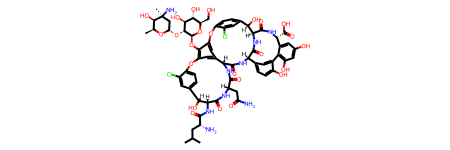

Select the "parent" fragment:


[20:39:45] Initializing MetalDisconnector
[20:39:45] Running MetalDisconnector
[20:39:45] Initializing Normalizer
[20:39:45] Running Normalizer
[20:39:45] Running LargestFragmentChooser


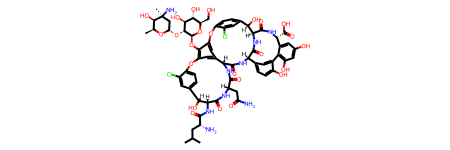

Neutralize the molecule:


[20:39:45] Running Uncharger


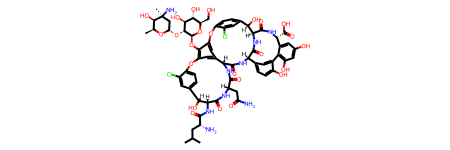

[20:39:47] Tautomer enumeration stopped at 1000 tautomers: max tautomers reached


Enumerate tautomers:


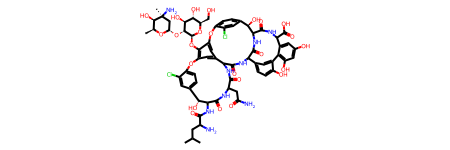

CC(C)CC(N)C(=O)NC1C(=O)NC(CC(N)=O)C(=O)NC2C(=O)NC3C(=O)NC(C(=O)NC(C(=O)O)c4cc(O)cc(O)c4-c4cc3ccc4O)[C@H](O)c3ccc(c(Cl)c3)Oc3cc2cc(c3O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O[C@H]2C[C@](C)(N)[C@H](O)[C@H](C)O2)Oc2ccc(cc2Cl)[C@H]1O
CC(C)CC(N)C(=O)NC1C(=O)NC(CC(N)=O)C(=O)NC2C(=O)NC3C(=O)NC(C(=O)NC(C(=O)O)c4cc(O)cc(O)c4-c4cc3ccc4O)[C@H](O)c3ccc(c(Cl)c3)Oc3cc2cc(c3O[C@@H]2O[C@H](CO)[C@@H](O)[C@H](O)[C@H]2O[C@H]2C[C@](C)(N)[C@H](O)[C@H](C)O2)Oc2ccc(cc2Cl)[C@H]1O


In [44]:
temp = standardize_smiles(df2["SMILE"][1],  verbose=True)
print(temp)

In [45]:
final_smiles = [standardize_smiles(x) for x in df2["SMILE"]]

[20:39:50] Initializing MetalDisconnector
[20:39:50] Running MetalDisconnector
[20:39:50] Initializing Normalizer
[20:39:50] Running Normalizer
[20:39:50] Initializing MetalDisconnector
[20:39:50] Running MetalDisconnector
[20:39:50] Initializing Normalizer
[20:39:50] Running Normalizer
[20:39:50] Running LargestFragmentChooser
[20:39:50] Running Uncharger
[20:39:50] Initializing MetalDisconnector
[20:39:50] Running MetalDisconnector
[20:39:50] Initializing Normalizer
[20:39:50] Running Normalizer
[20:39:50] Initializing MetalDisconnector
[20:39:50] Running MetalDisconnector
[20:39:50] Initializing Normalizer
[20:39:50] Running Normalizer
[20:39:50] Running LargestFragmentChooser
[20:39:50] Running Uncharger
[20:39:52] Tautomer enumeration stopped at 1000 tautomers: max tautomers reached
[20:39:52] Initializing MetalDisconnector
[20:39:52] Running MetalDisconnector
[20:39:52] Initializing Normalizer
[20:39:52] Running Normalizer
[20:39:52] Initializing MetalDisconnector
[20:39:52] Runn

In [46]:
df2['SMILE'] = final_smiles
df3 = df2.iloc[df2['SMILE'].drop_duplicates().index]
df3.reset_index(inplace = True,drop = True)

In [47]:
final_smiles = df3["SMILE"]
final_rewards = df3["Reward"]

In [48]:
#After fragmentation, each fragment contains a number followed by an asterisk that indicates
#where the molecule was cleaved, we need to remove that
def get_idx(frag):
  atoms = None
  idx = []
  try:
    atoms = Chem.MolFromSmiles(frag).GetAtoms()
  except:
    return idx

  for atom in atoms:
    if('*' in atom.GetSymbol()):
      for n in atom.GetNeighbors():
        if(n.GetIdx() > 0):
          idx.append(n.GetIdx()-1)
        else:
          idx.append(n.GetIdx())
  #idx contains out indexes where other fragments can join
  return idx

def get_proper_atc_idx(frag):
  blast_frag = list(frag)
  idx_lst = []
  for idx in range(len(blast_frag)):
    atom = blast_frag[idx]
    if(atom == '*'):
      blast_frag[idx] = 'L'
      refined_frag  = refine_smile(''.join(blast_frag))
      refined_frag = refined_frag.replace('L','*')
      blast_frag = list(frag)
      idx_lst.extend(get_idx(refined_frag))

  return idx_lst


def number_atoms(mol):
  mol2 = mol
  for i, atom in enumerate(mol2.GetAtoms()):
      # For each atom, set the property "molAtomMapNumber" to a custom number, let's say, the index of the atom in the molecule
      atom.SetProp("molAtomMapNumber", str(atom.GetIdx()))

  return mol2

#This function checks whether the fragments being generated have a point of connection or not

def refine_smile(text):
    """Removes all substrings in the input text that contain an integer followed by an asterisk within square brackets and parentheses."""
    pattern2 = r'\(\[\d+\*\]\)'
    pattern1 = r'\[\d+\*\]'
    modified_text = re.sub(pattern2, '', text)
    modified_text = re.sub(pattern1,'',modified_text)
    return modified_text

## Generate Fragments

In [49]:
def get_Frags(df = None):
  final_smiles = []
  final_reward = []
  fragments_dataset = []
  frags = set()
  for idx in tqdm.tqdm(df.index):
    smile = df["SMILE"].iloc[idx]
    curr_frags = BRICSDecompose(Chem.MolFromSmiles(smile))
    if None in [Chem.MolFromSmiles(refine_smile(x)) for x in curr_frags]:
      continue
    if(any('*' in x for x in curr_frags)):
      final_smiles.append(smile)
      final_reward.append(df['Reward'].iloc[idx])
      frags = frags.union(BRICSDecompose(Chem.MolFromSmiles(smile)))



  for frag in frags:
    fragments_dataset.append((refine_smile(frag),get_proper_atc_idx(frag)))

  #Now since duplicates have been removed, we also need to specify that the attachment indices

  unique_frags = []
  unique_frag_with_indices = []
  for idx in range(len(fragments_dataset)):
    f = fragments_dataset[idx]
    flag = 0
    for f2 in fragments_dataset[idx+1:]:
      if(f[0] == f2[0] and f[0] not in unique_frags):
        for x in f2[1]:
          f[1].append(x) if x not in f[1] else None
        flag = 1
    if(f[0] not in unique_frags):
      unique_frag_with_indices.append(f)
      unique_frags.append(f[0])
  return final_smiles,final_reward,frags,fragments_dataset

In [50]:
final_smiles,final_reward,frags,fragments_dataset = get_Frags(df3)

  0%|          | 52/38746 [00:01<10:12, 63.12it/s][20:49:13] Can't kekulize mol.  Unkekulized atoms: 0 1 2 5 6 7 9 10 11
[20:49:13] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 11 12
  0%|          | 72/38746 [00:01<09:03, 71.21it/s][20:49:13] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:49:13] Can't kekulize mol.  Unkekulized atoms: 0 1 2
[20:49:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8
  0%|          | 105/38746 [00:02<11:45, 54.75it/s][20:49:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2
[20:49:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2 4 5 6 7 8 9
  0%|          | 116/38746 [00:02<10:08, 63.49it/s][20:49:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2 7 8
[20:49:14] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4 5 6 7 8
  1%|          | 204/38746 [00:16<1:29:02,  7.21it/s][20:49:28] Can't kekulize mol.  Unkekulized atoms: 0 1 2
[20:49:28] Can't kekulize mol.  Unkekulized atoms: 0 1 2 5 6 7 9 10 11
[20:49:28] Can't kekulize mol.  Unke

In [52]:
print(frags)
print(fragments_dataset)
print(len(frags))
print(len(fragments_dataset))

{'[14*]c1[nH]c(=O)nnc1C', '[5*]NC=NO', '[8*]CCC(=O)NN', '[13*][C@]12N=C3Sc4ccc([N+](=O)[O-])cc4C(=O)N3[C@H](c3ccccc3O1)[C@H]2[15*]', '[5*]N1C[C@@H](C)[C@H]([13*])Oc2cc(C#CC3CCCCC3)ccc2S1(=O)=O', '[16*]c1c(C)[nH]c(=O)[nH]c1=O', '[1*]C(=O)n1c2ccccc2c2ccccc21', '[5*]N1CCC2(CC1)CN([10*])C(=O)CO2', '[5*]N1C[C@H]2COC[C@@]2([15*])C1', '[4*][C@@H]([8*])CC#C', '[16*]c1ccc(N=C(N)N=C(N)N)cc1', '[8*]CN1C(=O)[C@@]2(O[C@@H]([13*])[C@H]([Si](C)(C)c3ccc([16*])cc3)[C@H]2C)c2cc([16*])ccc21', '[7*]C1[C@@H]([15*])C[C@@]2(C)[C@H]1C[C@@H](O)[C@H]1[C@@]3(C)CC[C@@H](O)[C@@H](C)[C@H]3CC[C@@]12C', '[15*]C1CCC2C3CC(=O)C4CC(O)CCC4(C)C3CCC12C', '[16*]c1cc(S(N)(=O)=O)ccc1O', '[16*]c1c(C)c(O)c2ccccc2c1O', '[1*]C(=O)C([8*])([8*])O', '[13*][C@H]1C[C@@](C)(O)[C@@H](O)[C@@H](C)O1', '[13*]C1CSSCC2NC(=O)C([13*])NC(=O)C([13*])NC(=O)C3CSSCC(NC(=O)C(C)NC(=O)C4CCCN4C(=O)C([13*])NC(=O)C(CSSCC(N)C(=O)N3)NC2=O)C(=O)NC([13*])C(=O)NCC(=O)N1', '[4*]C[C@H](O)CC(=O)O', '[10*]N1CCCC1=O', '[16*]c1c(C)n[nH]c1C', '[16*]c1coc2cc3oc(=O)cc(

In [53]:
fragments_df = pd.DataFrame(fragments_dataset, columns=['Fragment_SMILES', 'Attachment_Points'])
display(fragments_df.tail)
fragments_df.to_csv('big_fragments.csv', index=False)

,Fragment_SMILES,Attachment_Points
0,c1[nH]c(=O)nnc1C,[0]
1,NC=NO,[0]
2,CCC(=O)NN,[0]
3,[C@]12N=C3Sc4ccc([N+](=O)[O-])cc4C(=O)N3[C@H](...,"[0, 23]"
4,N1C[C@@H](C)[C@H]Oc2cc(C#CC3CCCCC3)ccc2S1(=O)=O,"[0, 3]"
...,...,...
6021,c1ccc2c(c1)OCO2,"[0, 1, 4]"
6022,N1CC(=O)NC(=O)C1,[0]
6023,c1ccc2ccc(Cl)cc2n1,[0]
6024,n1cnc2c(nnn2)c1=O,[]


## Getting Fragments the good ol' way

In [24]:
unkekulized_mols = []
for idx in df3.index:
  smile = df3['SMILE'].iloc[idx]
  curr_frags = BRICSDecompose(Chem.MolFromSmiles(smile))
  if(any('*' in x for x in curr_frags)):
    refined_frags = list(map(refine_smile,curr_frags))
    if None in  [Chem.MolFromSmiles(x) for x in refined_frags]:
        unkekulized_mols.append(idx)

[20:29:41] Can't kekulize mol.  Unkekulized atoms: 0 1 5 6 7
[20:29:41] Can't kekulize mol.  Unkekulized atoms: 0 1 5 6 7
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekulize mol.  Unkekulized atoms: 0 1 2 3 4
[20:29:42] Can't kekuliz

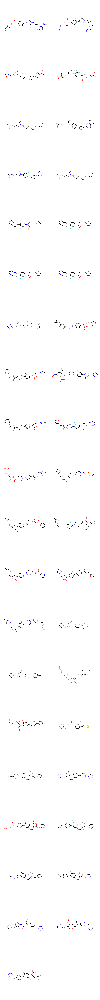

In [25]:
Chem.Draw.MolsToGridImage([Chem.MolFromSmiles(x) for x in df3['SMILE'].iloc[unkekulized_mols]],molsPerRow = 2,subImgSize = (500,500))

In [26]:
unprocessed_frags = []
for mol in [Chem.MolFromSmiles(x) for x in df3['SMILE'].iloc[unkekulized_mols]]:
  frags = BRICSDecompose(mol)
  refined_frags = [refine_smile(x) for x in frags]
  for idx in range(len(refined_frags)):
    if Chem.MolFromSmiles(refined_frags[idx]) is None:
      unprocessed_frags.append(orig_frags[idx])

[20:30:18] Can't kekulize mol.  Unkekulized atoms: 0 1 5 6 7


NameError: name 'orig_frags' is not defined

### Manual Fragmentation Process

In [ ]:
final_frags = [] #Run this once

In [ ]:
atch_idx = [] #Run this Once

In [ ]:
idx = -1 #Run this once or if you want to reset the index to -1 to restart from the first molecule

Compound Number: 0


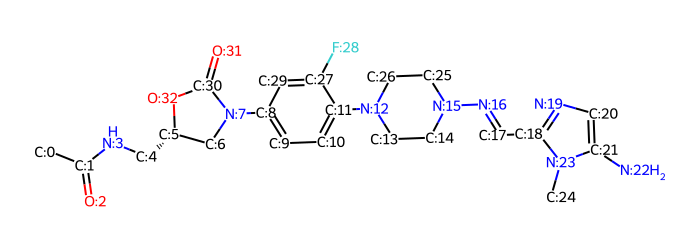

In [ ]:
#Didn't put this inside a loop because we need to pause and add the fragments for every molecule one by one
#Plus RDKIT doesn't display molecule drawings inside a loop
idx += 1
print("Compound Number:",idx)
mol2 = Chem.MolFromSmiles(df3['SMILE'].iloc[idx])
mol = Chem.MolFromSmiles(df3['SMILE'].iloc[idx])
Chem.Draw.MolsToGridImage([number_atoms(mol2)],subImgSize = (700,250),molsPerRow = 1)

In [ ]:
#The bonds that you think are breakable, You can also use the BRICS Decompose method but that is unable to fragment all the molecules
break_idx = [(1,3),(3,4),(4,5),(7,8),(11,12),(15,16),(17,18),(23,24),(21,22),(27,28)]

In [ ]:
#Now based on the breakable bonds, we break those bonds
mh = Chem.RWMol(Chem.AddHs(mol))
for x in break_idx:
  a1idx = x[0]
  a2idx = x[1]
  Chem.Kekulize(mh,clearAromaticFlags=True)
  mh.RemoveBond(a1idx,a2idx)
  # print(Chem.MolToSmiles(mh))

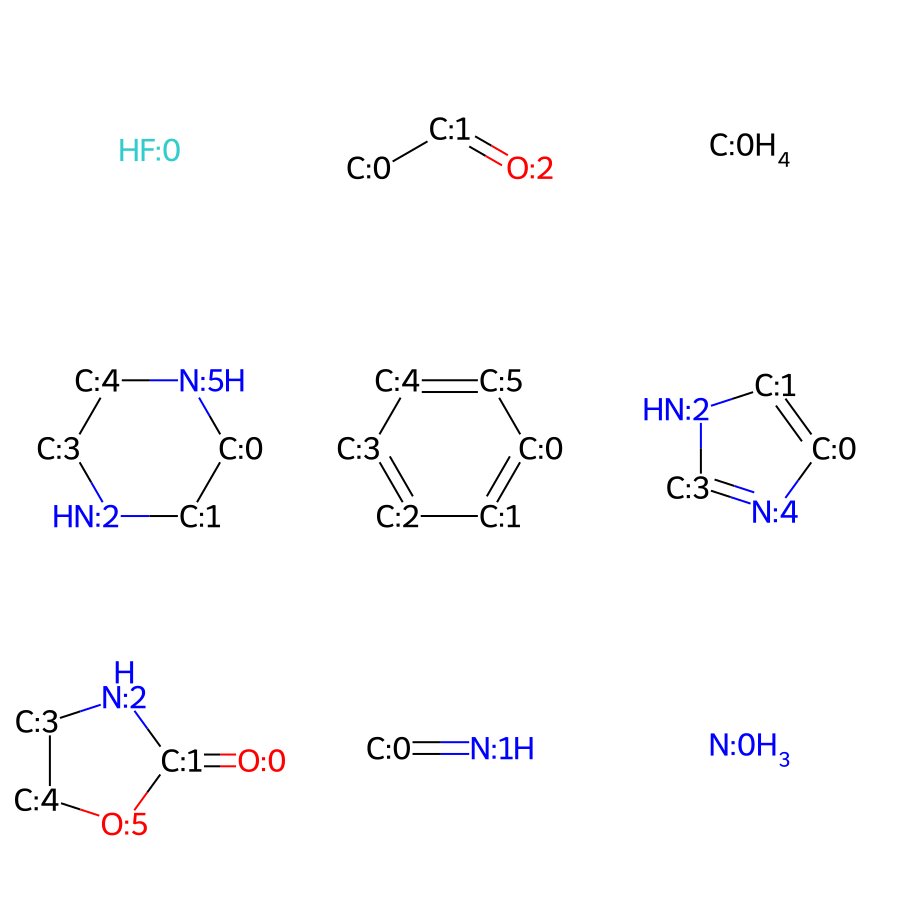

In [ ]:
#The resulting fragments will be displayed, and you have to take each fragment, look at the atom indices and
#prepare a at_idx list for each fragment which tells the model at what positions can we attach other fragments
#This block also checks for duplicate fragments so if the fragments are already present in the dataset, no image would be displayed
#and then you can run the process again
frags = [Chem.MolFromSmiles(x) for x in Chem.MolToSmiles(mh).split('.')]
curr_frags = []
for x in frags:
  sm = Chem.MolToSmiles(x)
  if(sm not in final_frags):
    final_frags.append(sm)
    curr_frags.append(sm)
  else:
    frags.remove(x)
try:
  im = Chem.Draw.MolsToGridImage(list(map(lambda x:number_atoms(Chem.MolFromSmiles(x)),curr_frags)),molsPerRow = 3,subImgSize = (300,300))
except:
  im = None
  print("Nothing to add")
im

In [ ]:
"""
After the Fragments have been generated and displayed, you have to look at each fragment and estimate at what positions
can other fragments attach and then put those indices in the at_idx list

So for instance  in the above picture there are Nine Fragments, and the corresponding indices are:
at_idx = [[0],[0,1],[0,0,0,0],[2,5],[0,3,5],[1,2,3],[2,4],[0,0],[0,0,0]]
"""

at_idx = [[0],[0,1],[0,0,0,0],[2,5],[0,3,5],[1,2,3],[2,4],[0,0],[0,0,0]]
for i in at_idx:
  atch_idx.append(i)
len(final_frags),len(atch_idx) #If the length of the final fragments and the atch_idx are equal it means You have correctly fragmented and indexed those particular fragments

(9, 9)

## Fragment Generation Done

In [ ]:
orig_frags = ['[9*]n1c([N+](=O)[O-])cnc1C', '[5*]N1CCN(N=CC[8*])CC1', '[16*]c1ccc([16*])c(F)c1', '[10*]N1C[C@H]([13*])OC1=O','[4*]C[8*]', '[1*]C(C)=O', '[5*]N[5*]']
frags = [refine_smile(x) for x in orig_frags]
mols = [number_atoms(Chem.MolFromSmiles(x)) for x in orig_frags]
idx = [get_idx(x) for x in orig_frags]
idx

[[0], [0, 6], [0, 3], [0, 2], [0, 0], [0], [0, 0]]

In [ ]:
mols_standardized = [Chem.MolFromSmiles(x) for x in df3['SMILES']]

In [ ]:
mol_pairs = []
for x,y in zip(frags,list(map(refine_smile,frags))):
  m1 = Chem.MolFromSmiles(x)
  m2 = Chem.MolFromSmiles(y)
  if(m1 is None or m2 is None):
    continue
  mol_pairs.append(number_atoms(m1))
  mol_pairs.append(number_atoms(m2))

mol_pairs = pd.DataFrame({'Mols':mol_pairs,"Index":range(len(mol_pairs))})
mol_pairs.set_index('Index',inplace = True)
mol_pairs = mol_pairs['Mols']

In [ ]:
# @title Getting Fragments and their indices right
# atc_idx = [get_proper_atc_idx(x) for x in orig_frags]
atch_idx =[[0],
 [0],
 [0],
 [0],
 [0],
 [0, 3, 4],
 [0],
 [0, 8],
 [0, 5],
 [0],
 [0, 8],
 [0],
 [0],
 [0, 0],
 [0, 9],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 8],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 8],
 [0],
 [0, 2],
 [0, 0],
 [0, 3],
 [0],
 [0, 13],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 3],
 [0, 0, 4],
 [0, 3],
 [0],
 [0, 8],
 [0],
 [0],
 [0, 0],
 [0],
 [0],
 [0, 4],
 [0],
 [0, 3],
 [0],
 [0],
 [0],
 [0, 0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 4],
 [0],
 [0],
 [0],
 [0, 3],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 4],
 [0],
 [0, 0],
 [0, 5],
 [0, 5],
 [0, 6],
 [0],
 [0, 0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 7],
 [0],
 [0, 3, 11],
 [0, 5],
 [0],
 [0],
 [0],
 [0],
 [0, 1],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 4],
 [0, 15],
 [0],
 [0],
 [0],
 [0, 9],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 8],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 3],
 [0],
 [0, 2],
 [0],
 [0],
 [0, 3, 4],
 [0, 2],
 [0],
 [0],
 [0, 0],
 [0],
 [0],
 [0],
 [0, 2],
 [0],
 [0],
 [0],
 [0],
 [0]]

## This portion is to visually identify the indices

In [ ]:
atch_indx = [x[1] for x in fragments_dataset]
atch_indx

[[0],
 [0],
 [0],
 [0],
 [0],
 [0, 2, 3, 4],
 [0],
 [0, 7],
 [0, 4],
 [0],
 [0, 7],
 [0],
 [0],
 [0, 0],
 [0, 8],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 7],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 7],
 [0],
 [0, 1],
 [0, 0],
 [0, 2],
 [0],
 [0, 12],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 2],
 [0, 0, 3],
 [0, 2],
 [0],
 [0, 7],
 [0],
 [0],
 [0, 0],
 [0],
 [0],
 [0, 3],
 [0],
 [0, 2],
 [0],
 [0],
 [0],
 [0, 0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 3],
 [0],
 [0],
 [0],
 [0, 2],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 3],
 [0],
 [0, 0],
 [0, 4],
 [0, 5],
 [0, 5],
 [0],
 [0, 0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 6],
 [0],
 [0, 2, 10],
 [0, 4],
 [0],
 [0],
 [0],
 [0],
 [0, 1],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 3],
 [0, 14],
 [0],
 [0],
 [0],
 [0, 8],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 7],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0],
 [0, 2],
 [0],
 [0, 1],
 [0],
 [0],
 [0, 2, 3],
 [0, 1]

In [ ]:
start = -50
end = 0

In [ ]:
start += 50
end += 50
Chem.Draw.MolsToGridImage(mol_pairs.loc[start:],molsPerRow = 2,subImgSize = (500,500))

In [ ]:
frags_list = []
for frag,idx in zip(list(map(refine_smile,frags)),atch_idx):
  frags_list.append((frag,idx))

#Now, let's merge the attachments indices of common fragments
frags_done = []
final_frags_list = []

for idx in range(len(frags_list)):
  f1 = frags_list[idx]
  for f2 in frags_list[idx+1:]:
    if(f1[0] in frags_done):
      break

    if (f1[0] == f2[0]):
      f1[1].extend(f2[1])
  if(f1[0] not in frags_done):
    final_frags_list.append(f1)
    frags_done.append(f1[0])

In [ ]:
final_frags_smiles = [x[0] for x in final_frags_list]
atch_idx = [x[1] for x in final_frags_list]

In [ ]:
df = pd.DataFrame({'SMILES':final_frags_smiles, 'Attachments':atch_idx})

In [ ]:
df.to_excel('Frags.xlsx')

In [ ]:
# @title Loading fragments from disk
#OR, copy paste the stored fragments list from disk
final_frags_list =[('C(=O)[C@@H]CC(=O)O', [0, 2]),
 ('CC(C)O', [0]),
 ('C(=O)N(CCCl)N=O', [0]),
 ('CCCCCC[C@H](C(=C)C(=O)O)C(=O)O', [0]),
 ('C(CC)[C@@H](C)[N+](=O)[O-]', [0]),
 ('SP(=O)(S)S', [0,3,4]),
 ('CCCCCCCC(=O)O', [0]),
 ('C(=O)[C@@H](O)C(C)(C)CO', [0]),
 ('C(C)CC[C@H](C)CCC[C@H](C)CCCC(C)C', [0]),
 ('N', [0, 0, 0]),
 ('C(CS)C(=O)O', [0]),
 ('C[C@@H]C', [0, 1]),
 ('S', [0, 0]),
 ('[C@@H]1[C@H]C1(C)C', [0, 1]),
 ('C(=O)C[C@H](O)[C@@H]CC(C)C', [0, 4]),
 ('CCCCCCCCCCCCCCCCCC', [0]),
 ('CCO', [0]),
 ('C(=O)[C@@H]C', [0,2,3]),
 ('C(=O)CCC(=O)N(O)CCCCC', [0, 11]),
 ('OP(=O)(O)O', [0, 3]),
 ('C1CC1(C)C', [0, 1]),
 ('CC=C', [0]),
 ('C(=O)[C@@H](N)CCC(=O)O', [0]),
 ('NC(=N)N(C)C', [0]),
 ('C(=O)C(=C)C', [0]),
 ('C(=O)CCCCCCC', [0]),
 ('C(=O)CCC(=O)CN', [0]),
 ('NC(=N)N', [0, 2]),
 ('C(=O)CC[C@H](N)C(=O)O', [0]),
 ('CCC', [0, 1]),
 ('[C@@H](C(=O)O)C(C)C', [0, 3]),
 ('NCS(=O)(=O)O', [0]),
 ('C(=O)C(=C)O', [0]),
 ('CC', [0, 1]),
 ('[C@H]1CO1', [0]),
 ('C(=O)CC', [0, 2, 3]),
 ('CCCCCC[C@@H](C(=C)C(=O)O)C(=O)O', [0]),
 ('OCF', [0]),
 ('C(O)C(Cl)(Cl)Cl', [0]),
 ('[C@@H](CS)C(=O)O', [0]),
 ('C(=O)C', [0, 2]),
 ('O[PbH2]O', [0, 1]),
 ('OCO/N=[N+](\\[O-])N(CC)CC', [0]),
 ('OC', [0]),
 ('C(=O)[C@@H]C(C)(C)C', [0, 2]),
 ('CCCC(=O)O', [0]),
 ('CCCCN', [0]),
 ('C[C@H]CO', [0, 1]),
 ('CCB(O)O', [0]),
 ('CCC[C@H](N)C(=O)O', [0]),
 ('C(C)(O)CN', [0]),
 ('[C@H]1O[C@@H]1', [0, 2]),
 ('CCCC(C)=O', [0]),
 ('CCCCCCC', [0, 5]),
 ('C(=O)CCCCCCC(=O)N/N=C/[C@H](O)[C@H](O)[C@@H](O)[C@H](C)O', [0]),
 ('SC(=N)N', [0]),
 ('NC(=N)SC', [0]),
 ('C(C)(C)C', [0]),
 ('C(Br)C(Cl)(Cl)Br', [0]),
 ('C(=O)C(O)C(C)(C)CO', [0]),
 ('O', [0, 0]),
 ('C(=O)[C@H](CC(C)C)[C@H](O)C(=O)NO', [0]),
 ('OC(O)P(=O)(O)CCCN', [0, 1]),
 ('C(=O)N(CCCl)[N+][O-]', [0]),
 ('C=O', [0, 0]),
 ('CCCC(C)(O)C=C', [0]),
 ('C(=O)/C(C)=N/NC(C)=O', [0]),
 ('[C@@H](CO)C(=O)O', [0]),
 ('C(=O)CCCCCCC(=O)NN', [0]),
 ('O[Cd]O', [0, 1]),
 ('CCCCCCCCC', [0]),
 ('CC(O)CO', [0]),
 ('[C@@H]1CO1', [0]),
 ('N/C(=N/C)NC', [0]),
 ('ON=C(N)N', [0]),
 ('OC=C', [0]),
 ('CC(=O)[C@@H](O)[C@H](O)[C@H](O)C', [0, 8]),
 ('CC[C@H](O)CCCCCC', [0]),
 ('O[Si](C#CCCCCCC)(C(C)C)C(C)C', [0]),
 ('[C@@H](CCC(N)=O)C(=O)O', [0]),
 ('C(C)CP(=O)(O)O', [0]),
 ('C[C@@H](N)C(=O)O', [0]),
 ('C(=O)C(C)S', [0]),
 ('C(C)(C)CCC[C@H](C)CC', [0, 8]),
 ('CCCC[C@H](N)C(=O)O', [0]),
 ('C(=O)[C@H](Br)C(C)C', [0]),
 ('C', [0, 0]),
 ('SP(=O)(O)O', [0]),
 ('c1cc1=O', [0, 1]),
 ('CC(=O)O', [0]),
 ('CC[C@H](N)C(=O)O', [0]),
 ('[C@H](O)[C@@H]O', [0, 1]),
 ('C(=O)C=[N+]=[N-]', [0]),
 ('[N+]#N', [0]),
 ('CCCCCCCCCCCCCCCC', [0]),
 ('C(=O)[C@H]C(C)C', [0, 2]),
 ('C(=O)CCC', [0, 3]),
 ('C(=O)[C@@H](N)CS', [0]),
 ('[C@@H](C)C(=O)O', [0]),
 ('C(=O)CCCCCCCC=O', [0, 8]),
 ('C(=O)[C@@H](N)CC(C)C', [0]),
 ('C(CC(=O)O)C(=O)O', [0]),
 ('CCCS(=O)(=O)O', [0]),
 ('NC', [0]),
 ('C(=O)CCN', [0]),
 ('[C@@H](CC)CO', [0]),
 ('[C@H](CC(=O)O)C(=O)O', [0]),
 ('[C@H](CC)C(=O)O', [0]),
 ('C(=O)[C@@H]CCC(=O)O', [0, 2]),
 ('CCC[C@H]C(N)=O', [0, 2]),
 ('C[C@H]C', [0, 1]),
 ('ONC(=N)N', [0]),
 ('C(=O)[C@H](C)N', [0]),
 ('C[C@H]CC(=O)O', [0, 1]),
 ('N(C)C(=N)N', [0]),
 ('SS(C)(=O)=O', [0]),
 ('CCCCCC(=O)O', [0]),
 ('C[C@@H](O)[C@H](O)[C@@H](O)[C@@H](O)CO', [0]),
 ('S[As](C)C', [0]),
 ('[C@@H](CC(=O)O)C(=O)O', [0]),
 ('C(=O)CCCCCCC(=O)N/N=C/[C@@H](O)[C@H](O)[C@H](O)CO', [0]),
 ('C(C(F)(F)F)C(F)(F)F', [0]),
 ('NC(=N)NO', [0]),
 ('CCCCC', [0, 2]),
 ('CCC[C@@H](N)C(=O)O', [0]),
 ('CCCCCCCCC(=O)O', [0]),
 ('S(=O)(=O)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)C(F)(F)F', [0]),
 ('C1(N)CC1', [0]),
 ('CC(=O)[C@H](O)[C@@H](O)C', [0, 6]),
 ('NC(C)=N', [0]),
 ('CC(N)=O', [0]),
 ('CCCCCC', [0]),
 ('CC=O', [0]),
 ('C[C@@H](C)O', [0]),
 ('C(=O)CCCCCCCCCCCCC', [0]),
 ('NC(=S)SSC(=S)N', [0, 0, 7, 7]),
 ('CCCCCCCCCCCCCC', [0]),
 ('C(=O)CCCCCCC(=O)N/N=C/[C@H](O)[C@@H](O)[C@@H](O)[C@H](O)C(=O)O', [0]),
 ('CC(F)(F)F', [0]),
 ('[C@@H](C(=O)O)[C@H](C)CC', [0]),
 ('[C@@H](CC(C)C)[C@@H](O)CC(=O)O', [0]),
 ('C(=O)[C@@H](C#N)C=O', [0, 5]),
 ('C(O)C(=O)O', [0]),
 ('[C@@H](CC(C)C)C(=O)O', [0]),
 ('CCCC', [0, 2]),
 ('CCC(=O)O', [0, 0]),
 ('CCCO', [0]),
 ('C[C@@H](O)[C@@H](O)[C@@H](O)[C@@H](O)C', [0, 8]),
 ('CCCC(C)CC=O', [0]),
 ('CCCCCCCCC(N)=O', [0]),
 ('CC(O)CC(O)CCCCCCCCCCCC#C', [0]),
 ('CC[C@@H](N)C(=O)O', [0]),
 ('CC(O)C(O)C(O)C(O)CO', [0]),
 ('CCCCCCCCCCC(=O)O', [0]),
 ('C(=O)CCC=O', [0, 3, 2]),
 ('CCCCCCCCCC(=O)O', [0]),
 ('[C@@H](C=O)[C@@H](O)[C@H](O)[C@H](O)CO', [0]),
 ('C(=O)[C@@H]CCC(N)=O', [0, 2]),
 ('CCCN', [0]),
 ('OP(=O)([O-])O', [0, 4]),
 ('C(C)C', [0]),
 ('NCP(=O)(O)O', [0]),
 ('CC#CC', [0]),
 ('C(=O)O', [0]),
 ('NC(N)=S', [0]),
 ('CCC[C@@](C)(O)C=C', [0]),
 ('C[C@@H](O)[C@@H](O)[C@@H](O)[C@@H](O)CO', [0]),
 ('CC(C)=O', [0]),
 ('C(=O)[C@@H]C(C)C', [0, 2]),
 ('CCCCCCCC', [0]),
 ('CCCCC(=O)O', [0]),
 ('C(=O)C(=O)O', [0]),
 ('OP(=S)(O)SCSP(=S)(O)O', [0, 2, 8, 9]),
 ('NC(=N)NC#N', [0]),
 ('NC(=N)NC', [0]),
 ('C(=O)[C@@H]CCC', [0, 2, 4]),
 ('C(C)(C)CO', [0]),
 ('NC(=S)N', [0, 2]),
 ('C(=O)[C@@H](N)CCC', [0, 5]),
 ('CCCCO', [0]),
 ('S[N+][O-]', [0]),
 ('CC[C@H](C)CCC', [0, 5]),
 ('C(CCC(N)=O)C(=O)O', [0]),
 ('SC', [0]),
 ('[C@H](C[C@H](O)C(C)(O)CCC)CC', [0, 8, 9]),
 ('CCCCCCO', [0]),
 ('C(=O)CCCCCCC(=O)N/N=C/[C@H](O)[C@@H](O)[C@H](O)CO', [0]),
 ('C(CCC(=O)O)C(=O)O', [0]),
 ('CCC(N)C(=O)O', [0]),
 ('CC(O)CC(=O)[O-]', [0]),
 ('C(C)(C)CCCC(C)CC', [0, 8]),
 ('C/C(=N/O)C(N)=O', [0]),
 ('CCN', [0]),
 ('C(=O)C=C', [0]),
 ('C(=O)[C@H](N)C', [0, 3]),
 ('C(C)(C)CC', [0]),
 ('C(=O)[C@H]CCC', [0, 2, 4]),
 ('CC(C)(C)CCC', [0, 2]),
 ('CCCl', [0]),
 ('C(=O)CCCCCCCCCCCCCCC', [0]),
 ('[C@@H](CCCC[C@@H](C)CCC)[C@@H](CO)C(=O)O', [0, 7]),
 ('C(C)=O', [0]),
 ('C[C@H](O)CC(=O)O', [0]),
 ('C[C@@H](O)CN', [0]),
 ('C(=O)CN', [0]),
 ('C(O)CCC(=O)O', [0]),
 ('NC(N)=N[N+](=O)[O-]', [0]),
 ('C(=O)CC[C@H](C)N', [0]),
 ('N(CP(=O)(O)O)CP(=O)(O)O', [0]),
 ('C(=O)NNC[C@@H](O)C', [0, 6]),
 ('[C@H](CC(C)C)C(=O)O', [0]),
 ('S[NH2+][O-]', [0]),
 ('C(=O)C[C@H](O)C[C@@H]CCCCC', [0, 5]),
 ('NC=O', [0]),
 ('C(=O)CCS', [0, 2]),
 ('C(=O)C[C@H](O)C[C@H](O)CCCCC', [0]),
 ('CCCC[C@@H](N)C(=O)O', [0]),
 ('[C@H]([C@H](C)CCCC)[C@@H]C[C@@H](C)C[C@H](O)CCCC[C@@H](O)C[C@H](O)[C@H](C)N',
  [0, 6]),
 ('C[C@H](N)C(=O)O', [0]),
 ('C(CC(C)C)C(=O)O', [0]),
 ('C(=O)CC[C@@H](N)C(=O)O', [0]),
 ('C[C@@H][C@H][C@H][C@H][C@H]C', [0,1, 2, 3, 4, 5,6]),
 ('CCCC(N)C(=O)O', [0]),
 ('[C@@H](C)P(=O)(O)O', [0]),
 ('SP(=S)(OC)OC', [0]),
 ('C(=O)[C@H](CO)[C@H](O)CCCC[C@H](C)CCC', [0, 13]),
 ('C1CC1', [0]),
 ('N(C)C', [0]),
 ('SS', [0, 1]),
 ('C(=O)CCC(N)C(=O)O', [0]),
 ('C(=O)CCCCCCCCCCCCCCCCC', [0]),
 ('C(=O)NNC[C@H](O)CC', [0]),
 ('CC(N)C(=O)O', [0]),
 ('SS(=O)(=O)O', [0]),
 ('C(=O)[C@H](O)C(C)(C)CO', [0]),
 ('CC(=O)CC[C@H](N)C(=O)O', [0]),
 ('CCCCCN(O)C(C)=O', [0]),
 ('C(=O)CCCCCCCC', [0, 8]),
 ('CC(C)C', [0]),
 ('C(=O)/C(C)=N\\O', [0]),
 ('C(=O)CCCC', [0, 4]),
 ('[N+](C)(C)C', [0]),
 ('OP(=O)(OC)OC', [0]),
 ('CCC[C@@H]C(N)=O', [0, 2]),
 ('C(C)CCC(C)CCCC(C)CCCC(C)C', [0]),
 ('C(N)=O', [0]),
 ('OS(C)(=O)=O', [0]),
 ('[C@@H]1C[C@H]1C', [0]),
 ('C(=O)CCCCCCC=O', [0, 7]),
 ('CCC[C@@H](C)CCO', [0]),
 ('C(=O)[C@@H]CC(C)C', [0, 2]),
 ('C(=O)C[C@@H](CC(=O)O)C(=O)O', [0]),
 ('C(=O)CCC(=O)N(O)CCCCCN', [0]),
 ('OP(=O)(F)O', [0, 4]),
 ('C[C@@H](O)CC(=O)O', [0]),
 ('SCS', [0, 1]),
 ('CCCCCCCCCCCC', [0]),
 ('C(=O)CC(C)C', [0]),
 ('CCS', [0]),
 ('C(=O)[C@@H](C)N', [0]),
 ('[C@@H](CCC(=O)O)C(=O)O', [0]),
 ('[C@@H]1C[C@@H]1', [0, 1]),
 ('OS(N)(=O)=O', [0]),
 ('C(=O)CC(O)(CC=O)C(=O)O', [0, 5]),
 ('C(=O)[C@@H]CC', [0, 2, 3]),
 ('CCCCN(O)C(C)=O', [0]),
 ('C(=O)C=O', [0, 2])]

## GFlowNet begins

In [ ]:
#Note TPUs don't work well with GFlowNets

import torch
from gflownet.config import init_empty, Config
from gflownet.models.graph_transformer import GraphTransformerGFN
from gflownet.envs.graph_building_env import GraphBuildingEnv
from gflownet.envs.frag_mol_env import FragMolBuildingEnvContext
from gflownet.envs.mol_building_env import MolBuildingEnvContext #Using this to build graphs didn't work
from gflownet.algo.trajectory_balance import TrajectoryBalance
from gflownet.algo.graph_sampling import GraphSampler

In [ ]:
if torch.cuda.is_available():
    from gflownet.utils.misc import set_main_process_device
    # model.cuda()
    dev = torch.device('cuda')
    set_main_process_device(dev)
else:
    dev = torch.device('cpu')
dev

device(type='cpu')

In [ ]:
frags_list = [(x,y) for x,y in zip(final_frags,atch_idx)]

NameError: name 'final_frags' is not defined

In [ ]:
frags_list = [('C',[0,0,0,0]),('C=C',[0,0,1,1])]

In [ ]:
torch.manual_seed(1)  # For demonstration purposes
cfg = Config()
env = GraphBuildingEnv()
ctx = FragMolBuildingEnvContext(fragments = final_frags_list,check_iter = False)
model = GraphTransformerGFN(ctx, cfg).to(dev)
algo = TrajectoryBalance(env, ctx, cfg)

Didn't process 0 fragments


In [ ]:
#To test what samples are generated once before or after the training
def test_model(num_samples = 16, sub_img_size = 500,mols_per_row = 4):
  trajs = algo.create_training_data_from_own_samples(model,num_samples)
  gen_mols = [ctx.graph_to_obj(x['result']) for x in trajs]
  gen_mols_smiles = [Chem.MolToSmiles(mol) for mol in gen_mols]
  return gen_mols_smiles,gen_mols,Chem.Draw.MolsToGridImage(gen_mols, molsPerRow=mols_per_row, subImgSize=(sub_img_size, sub_img_size))

In [ ]:
frags_list = [('c1cccc(F)c1', [2, 6]),
 ('N1CCOC1=O', [0]),
 ('N1CCNCC1', [0, 3]),
 ('CC(=O)', [1]),
 ('N',[0,0]),
 ('C',[0,0]),
 ('N=C',[0,1]),
 ('c4nccN4',[0,1,4])]

CC(=O)NC[C@H]1CN(c2ccc(N3CCN(N=Cc4ncc(N)n4C)CC3)c(F)c2)C(=O)O1


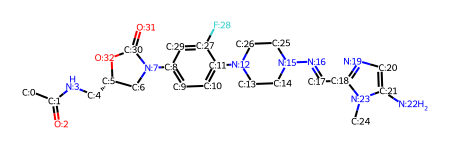

In [ ]:
print(df3['SMILE'].iloc[0])

sub_mol = Chem.MolFromSmiles('C1CN(c2ccc(N3CCNCC3)c(F)c2)C(=O)O1')
# sub_mol
number_atoms(Chem.MolFromSmiles(df3['SMILE'].iloc[0]))

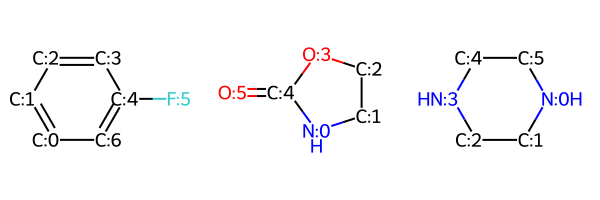

In [ ]:
Chem.Draw.MolsToGridImage(list(map(lambda x:number_atoms(Chem.MolFromSmiles(refine_smile(x))),BRICSDecompose(sub_mol))))

In [ ]:
frags = list(map(refine_smile,BRICSDecompose(sub_mol)))
atch_idx = [[2,6],[0],[0,3]]
frags_list = [(x,y) for x,y in zip(frags,atch_idx)]

In [ ]:
parent = Chem.MolFromSmiles(df3['SMILE'].iloc[0])
# parent = Chem.MolFromSmiles('CCC=C')
ctx.obj_to_graph(parent)

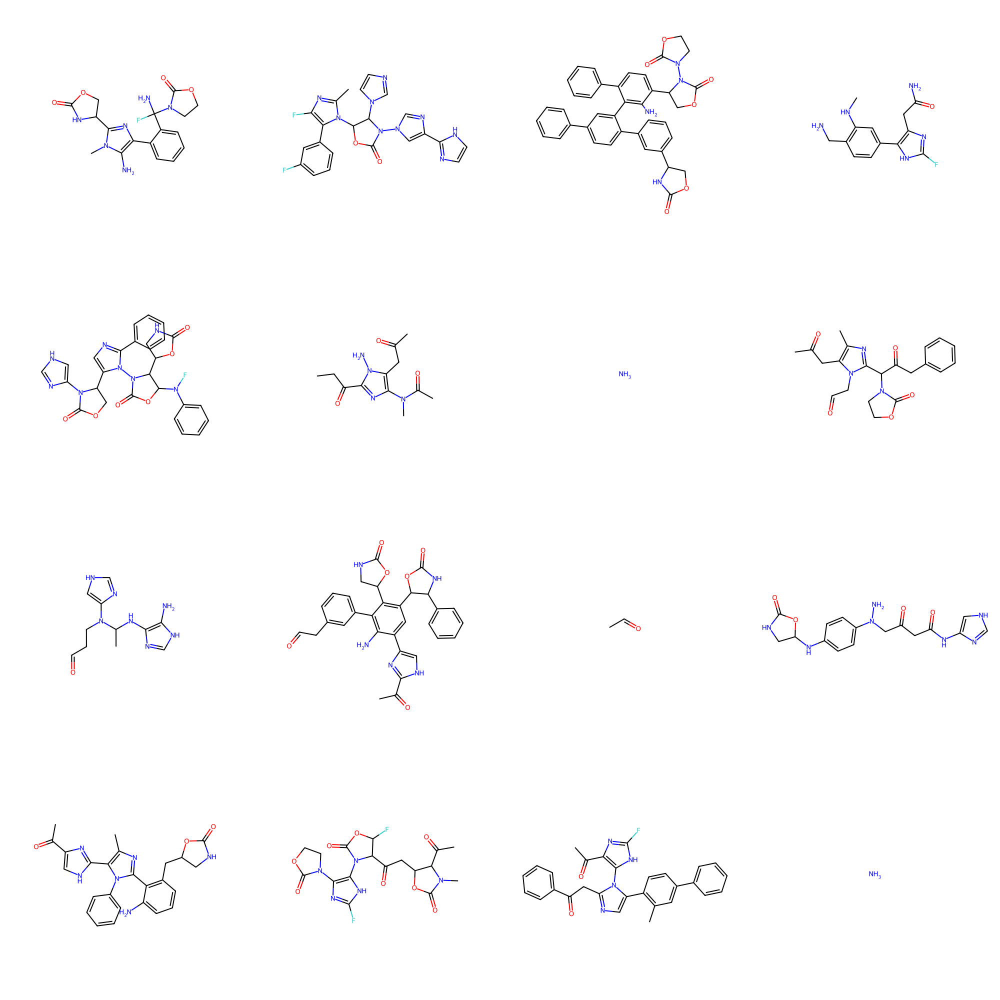

In [ ]:
_,_,im = test_model()
im

In [ ]:
def model_train(num_epochs = 100,graphs = None,rewards = None,batch_size = 1):
  """
  Function to train the model
  params: g_s - list of graphs, r_s - list of rewards
  """
  g_s = graphs
  r_s = rewards
  opt = torch.optim.Adam(model.parameters())
  for epoch in range(1,num_epochs+1):
    sample_count = 1
    losses = []
    avg_rewards = []
    for i in tqdm.tqdm(range(len(g_s))):
        g = [g_s[sample_count]]
        trajs = algo.create_training_data_from_graphs(g,model)
        rewards = torch.tensor([r_s[sample_count]])

        batch = algo.construct_batch(trajs, None, rewards).to(dev)
        loss, _ = algo.compute_batch_losses(model, batch)
        if(not(loss < 10000)):
          loss.backward()
          opt.step()
          opt.zero_grad()

          losses.append(loss.item())
          avg_rewards.append(rewards)
        else:
          losses.append(0)
          avg_rewards.append(0)
        sample_count += 1

    if(epoch % 10==0):
      print("Epoch:",epoch,"Mean Loss:",np.mean(losses),"Mean Reward:",np.mean(avg_rewards))

In [ ]:
# @title Graph Generation
#Generating Graphs for the respective molecules and removing those which are causing null losses
# TODO: The null losses have something to do with batch.actions as some log operation is being applied onto it, and it results in inf
# null loss
final_smiles = df3['SMILE'][:30]
final_reward = df3['Reward'][:30]
graphs = []
g_s = []
r_s = []
for smile in tqdm.tqdm(final_smiles):
    mol = Chem.MolFromSmiles(smile)
    graphs.append(ctx.obj_to_graph(mol))
print("Before removing Null:",len(graphs))
final_rewards = [final_reward[idx] for idx in range(len(final_reward)) if graphs[idx] is not None]
graphs = [x for x in graphs if x is not None]
print("After Removing Null:",len(graphs))
for g,r in zip(graphs,final_rewards):
  g = [g]
  r = torch.tensor([r])
  trajs = algo.create_training_data_from_graphs(g,model)
  batch = algo.construct_batch(trajs, None, torch.tensor(np.array(r))).to(dev)
  loss, _ = algo.compute_batch_losses(model, batch)
  if not(loss == np.inf or loss == np.nan):
    g_s.append(g[0])
    r_s.append(r[0])

In [ ]:
ctx.obj_to_graph(sub_mol)

In [ ]:
#Training the model
model_train(num_epochs = 100,graphs = g_s,rewards = r_s,batch_size = 1)

In [ ]:
loss == torch.tensor(torch.inf)

tensor(True, device='cuda:0')

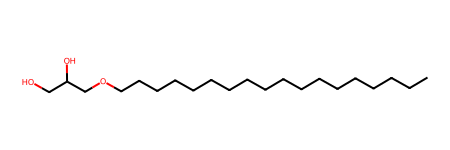

In [ ]:
ctx.graph_to_obj(graphs[0])

In [ ]:
g_s = []
r_s = []
for g,r in zip(graphs,final_rewards):
  g = [g]
  r = torch.tensor([r])
  with torch.no_grad():
    trajs = algo.create_training_data_from_graphs(g,model)
    batch = algo.construct_batch(trajs, None, r).to(dev)
    loss, _ = algo.compute_batch_losses(model, batch)
  if loss.item() < 10000:
    g_s.append(g[0])
    r_s.append(r[0])
  else:
    print(loss)

In [ ]:
len(g_s)

66

In [ ]:
num_epochs = 100
opt = torch.optim.Adam(model.parameters())
for epoch in tqdm.tqdm(range(1,num_epochs+1)):
  sample_count = 1
  losses = []
  avg_rewards = []
  for i in range(len(g_s)):
      g = [g_s[i]]
      with torch.no_grad():
        trajs = algo.create_training_data_from_graphs(g,model)
        rewards = torch.tensor([r_s[i]])
        batch = algo.construct_batch(trajs, None, rewards).to(dev)

      loss, _ = algo.compute_batch_losses(model, batch)
      if(loss < 100000):
        loss.backward()
        opt.step()
        opt.zero_grad()

        losses.append(loss.item())
        avg_rewards.append(rewards[0])
      else:
        losses.append(0)
        avg_rewards.append(0)

      sample_count += 1
  comp_list =  list(zip(g_s,r_s))
  np.random.shuffle(comp_list)
  g_s = [x[0] for x in comp_list]
  r_s = [x[1] for x in comp_list]
  if(epoch % 10==0):
    print("\nEpoch:",epoch,"Mean Loss:",np.mean(losses),"Mean Reward:",np.mean(avg_rewards))

 10%|█         | 10/100 [00:03<00:35,  2.57it/s]


Epoch: 10 Mean Loss: 31.813679584115743 Mean Reward: 1.7044409103994955


 20%|██        | 20/100 [00:08<00:42,  1.87it/s]


Epoch: 20 Mean Loss: 7.5160645008087155 Mean Reward: 0.9655353005064304


 30%|███       | 30/100 [00:12<00:27,  2.56it/s]


Epoch: 30 Mean Loss: 1.7046278908848762 Mean Reward: 0.9655353005064304


 40%|████      | 40/100 [00:16<00:24,  2.47it/s]


Epoch: 40 Mean Loss: 15.735559177398681 Mean Reward: 1.817755755706178


 50%|█████     | 50/100 [00:21<00:25,  1.93it/s]


Epoch: 50 Mean Loss: 0.8963363879360259 Mean Reward: 1.078850145813113


 60%|██████    | 60/100 [00:25<00:16,  2.45it/s]


Epoch: 60 Mean Loss: 63.7123645067215 Mean Reward: 7.164255913713919


 70%|███████   | 70/100 [00:29<00:11,  2.51it/s]


Epoch: 70 Mean Loss: 13.742252826690674 Mean Reward: 1.817755755706178


 80%|████████  | 80/100 [00:33<00:10,  1.99it/s]


Epoch: 80 Mean Loss: 4.699345862865448 Mean Reward: 0.9655353005064302


 90%|█████████ | 90/100 [00:38<00:04,  2.36it/s]


Epoch: 90 Mean Loss: 23.636326837539674 Mean Reward: 6.425350303820854


100%|██████████| 100/100 [00:42<00:00,  2.36it/s]


Epoch: 100 Mean Loss: 3.112720489501953 Mean Reward: 1.078850145813113


In [ ]:
_,_,im = test_model(num_samples = 100)

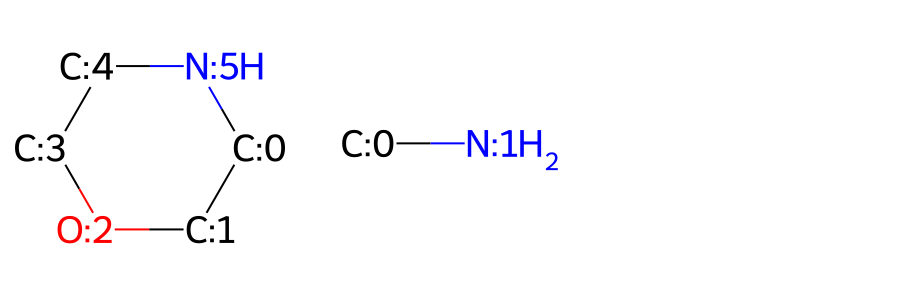

In [ ]:
im

In [ ]:
g = [g_s[0]]
trajs = algo.create_training_data_from_graphs(g,model)
rewards = torch.tensor([r_s[0]])

batch = algo.construct_batch(trajs, None, rewards).to(dev)
loss, _ = algo.compute_batch_losses(model, batch)
print(loss)
# loss.backward()
# opt.step()
# opt.zero_grad()


tensor(269.8245, device='cuda:0', grad_fn=<AddBackward0>)


In [ ]:
ultimate_frags = []
halicin_smile = 'C1=C(SC(=N1)SC2=NN=C(S2)N)[N+](=O)[O-]'

f = list(BRICSDecompose(Chem.MolFromSmiles(smile)))
for f1 in f:
  if not '*' in BRICSDecompose(Chem.MolFromSmiles(refine_smile(f1))):
    ultimate_frags.append(f1)
    smile = refine_smile(f1)
    break
  else:
    f.append(Chem.MolFromSmiles(refine_smile(f1)))
halicin_frags = f
halivin_frags_refined = [refine_smile(x) for x in halicin_frags]

In [ ]:
halicin_smile = 'Nc1nnc(Sc2ncc([N+](=O)[O-])s2)s1'
smiles,mols = test_model(num_samples = 1000)
while(halicin_smile not in smiles):
  smiles,mols = test_model(num_samples = 1000)
print("Found Halicin")

In [ ]:
coupled = []
for a,b in zip(halicin_frags,halivin_frags_refined):
    coupled.append(number_atoms(Chem.MolFromSmiles(a)))
    coupled.append(number_atoms(Chem.MolFromSmiles(b)))

In [ ]:
halicin_atch_idx = [[0],[0],[0,0]]
final_frags_list.extend([(a,b) for a,b in zip(halivin_frags_refined,halicin_atch_idx)])

In [ ]:
df = pd.read_excel("/content/GFlow_6.xlsx")
all_frags = set([])
for x in df["SMILES"]:
  all_frags.update(BRICSDecompose(Chem.MolFromSmiles(x)))
all_frags_refined = [refine_smile(x) for x in all_frags]

[09:06:55] Unusual charge on atom 0 number of radical electrons set to zero


In [ ]:
for x in halivin_frags_refined:
  if not(x in all_frags_refined):
    print(x)